#### Data Repository
- https://dataverse.harvard.edu/dataset.xhtml?persistentId=doi:10.7910/DVN/DBW86T

#### Paper
- https://www.thelancet.com/journals/lanonc/article/PIIS1470-2045(19)30333-X/fulltext
- https://www.nature.com/articles/s41591-020-0942-0

#### Notebooks
- https://github.com/ishanrai05/skin-cancer-prediction/blob/master/notebook/skin-cancer-prediction.ipynb
- https://github.com/IFL-CAMP/SLClassificationAnEducationalCode-MEC2019/blob/master/SkinLesionClassification.ipynb

#### Tutorial
- https://medium.com/miccai-educational-initiative/skin-cancer-image-classification-an-educational-guide-2a043a1beb59
- https://www.kaggle.com/jnegrini/ham10000-analysis-and-model-comparison?scriptVersionId=57671423
- https://github.com/bnsreenu/python_for_microscopists   # 203b
- https://github.com/bnsreenu/python_for_microscopists/blob/master/203b_skin_cancer_lesion_classification_V4.0.py

### Código

#### Libraries

In [1]:
# https://youtu.be/fyZ9Rxpoz2I
"""
Skin cancer lesion classification using the HAM10000 dataset
Dataset link:
https://www.kaggle.com/kmader/skin-cancer-mnist-ham10000
Data description: 
https://arxiv.org/ftp/arxiv/papers/1803/1803.10417.pdf
The 7 classes of skin cancer lesions included in this dataset are:
Melanocytic nevi (nv)
Melanoma (mel)
Benign keratosis-like lesions (bkl)
Basal cell carcinoma (bcc) 
Actinic keratoses (akiec)
Vascular lesions (vas)
Dermatofibroma (df)
"""


import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
from glob import glob
import seaborn as sns
from PIL import Image
import imageio

np.random.seed(42)
from sklearn.metrics import confusion_matrix

import keras
from keras.utils.np_utils import to_categorical # used for converting labels to one-hot-encoding
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPool2D, BatchNormalization
from sklearn.model_selection import train_test_split
from scipy import stats
from sklearn.preprocessing import LabelEncoder

#### Importando la metadata

In [2]:
path = 'C:/Users/carlo/Documents/HAM10000/'
data_dir = os.listdir(path)
metadata = pd.read_csv('C:/Users/carlo/Documents/HAM10000/HAM10000_metadata.csv')

In [3]:
SIZE=32

# codificando etiquetas (tipos de lesiones) a valores numéricos con LabelEncoder
le = LabelEncoder()
le.fit(metadata['dx'])
LabelEncoder()
print(list(le.classes_))
 
metadata['label'] = le.transform(metadata["dx"]) 
print(metadata.sample(10))

['akiec', 'bcc', 'bkl', 'df', 'mel', 'nv', 'vasc']
        lesion_id      image_id   dx    dx_type   age     sex  \
1617  HAM_0007180  ISIC_0033272  mel      histo  65.0    male   
8128  HAM_0007195  ISIC_0031923   nv      histo  40.0  female   
2168  HAM_0001835  ISIC_0026652  mel      histo  65.0    male   
1090  HAM_0000465  ISIC_0030583  bkl  consensus  35.0  female   
7754  HAM_0001720  ISIC_0034010   nv      histo  45.0    male   
8071  HAM_0006333  ISIC_0024424   nv      histo  35.0    male   
7423  HAM_0004548  ISIC_0032832   nv      histo  45.0  female   
8984  HAM_0006526  ISIC_0026671   nv      histo  55.0    male   
2310  HAM_0003102  ISIC_0032389  mel      histo  65.0    male   
7256  HAM_0004260  ISIC_0025525   nv      histo  65.0    male   

         localization        dataset  label  
1617             face   vidir_modern      4  
8128  lower extremity    vienna_dias      5  
2168             back      rosendahl      4  
1090            trunk  vidir_molemax      2  
775

#### Examinando la distribución de los datos

In [4]:
lesion_counts = metadata['dx'].value_counts() # contando las ocurrencias por clase
lesion_counts = lesion_counts.to_frame()     # pandas series core a dataframe
lesion_counts

,dx
nv,6705
mel,1113
bkl,1099
bcc,514
akiec,327
vasc,142
df,115


In [5]:
plt_a = lesion_counts.plot(kind='bar', color = ['darkred'], figsize=(6,4.5)) # , color=['darkblue']
plt_a.set_ylabel('Conteos', fontsize=14)
plt_a.set_xlabel('Lesión', fontsize=14)
plt_a.set_title('Tipo de lesión', fontsize=15)
plt_a.tick_params(axis='both', which='major', labelsize=13)

plt_a.axhline(y=500, color='gray', linestyle='--')
plt_a.axhline(y=1000,color='gray', linestyle='--')
plt_a.text(6.9, 1000, '1000', fontsize=10, va='center', ha='center', backgroundcolor='w')
plt_a.text(6.85, 500, '500', fontsize=10, va='center', ha='center', backgroundcolor='w')
plt_a.get_legend().remove()
plt_a.figure.savefig('lesion_counts.png', bbox_inches = 'tight')
plt.close()

In [6]:
sex_counts = metadata['sex'].value_counts() # contando las ocurrencias por clase
sex_counts = sex_counts.to_frame()     # pandas series core a dataframe
sex_counts

,sex
male,5406
female,4552
unknown,57


In [7]:
plt_b = sex_counts.plot(kind='bar', color = ['darkred'], figsize=(3,4.5)) # , color=['darkblue']
plt_b.set_ylabel('Conteos', fontsize=14)
plt_b.set_xlabel('Sexo', fontsize=14)
plt_b.set_title('Lesiones por sexo', fontsize=15)
plt_b.tick_params(axis='both', which='major', labelsize=13)
plt_b.get_legend().remove()
plt_b.figure.savefig('sex_counts.png', bbox_inches = 'tight')
plt.close()

In [8]:
localization_counts = metadata['localization'].value_counts() # contando las ocurrencias por clase
localization_counts = localization_counts.to_frame()     # pandas series core a dataframe
localization_counts

,localization
back,2192
lower extremity,2077
trunk,1404
upper extremity,1118
abdomen,1022
face,745
chest,407
foot,319
unknown,234
neck,168


In [9]:
plt_c = localization_counts.plot(kind='bar', color = ['darkred'], figsize=(8,5)) # , color=['darkblue']
plt_c.set_ylabel('Conteos', fontsize=14)
plt_c.set_xlabel('Localización', fontsize=14)
plt_c.set_title('Lesiones por zona corporal', fontsize=15)
plt_c.tick_params(axis='both', which='major', labelsize=13)
plt_c.axhline(y=300, color='gray', linestyle='--')
plt_c.axhline(y=100,color='gray', linestyle='--')
plt_c.text(15, 300, '300', fontsize=10, va='center', ha='center', backgroundcolor='w')
plt_c.text(15, 100, '100', fontsize=10, va='center', ha='center', backgroundcolor='w')
plt_c.get_legend().remove()
plt_c.figure.savefig('localization_counts.png', bbox_inches = 'tight')
plt.close()

In [10]:
expert_validation_counts = metadata['dx_type'].value_counts()      # contando las ocurrencias por clase
expert_validation_counts = expert_validation_counts.to_frame()     # pandas series core a dataframe
expert_validation_counts

,dx_type
histo,5340
follow_up,3704
consensus,902
confocal,69


In [11]:
plt_d = expert_validation_counts.plot(kind='bar', color = ['darkred'], figsize=(3.5,4.5)) # , color=['darkblue']
plt_d.set_ylabel('Conteos', fontsize=14)
plt_d.set_xlabel('Clases', fontsize=14)
plt_d.set_title('Conocimiento Experto de las imágenes', fontsize=15)
plt_d.tick_params(axis='both', which='major', labelsize=13)
plt_d.axhline(y=1000, color='gray', linestyle='--')
plt_d.text(3.9, 1000, '1000', fontsize=10, va='center', ha='center', backgroundcolor='w')
plt_d.get_legend().remove()
plt_d.figure.savefig('expert_validation_counts.png', bbox_inches = 'tight')
plt.close()

In [12]:
sample_age = metadata[pd.notnull(metadata['age'])]
a = sns.distplot(sample_age['age'], fit=stats.norm, color='red');
a.axes.set_title("Distribución de Edad",fontsize=15)
a.set_xlabel("edad",fontsize=14)
a.set_ylabel("Densidad",fontsize=14)

sns.set(rc={'figure.figsize':(8,4)})
a.figure.savefig('sample_age.png', bbox_inches = 'tight')
plt.close()

C:\ProgramData\Anaconda3\envs\ipykernel_py3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


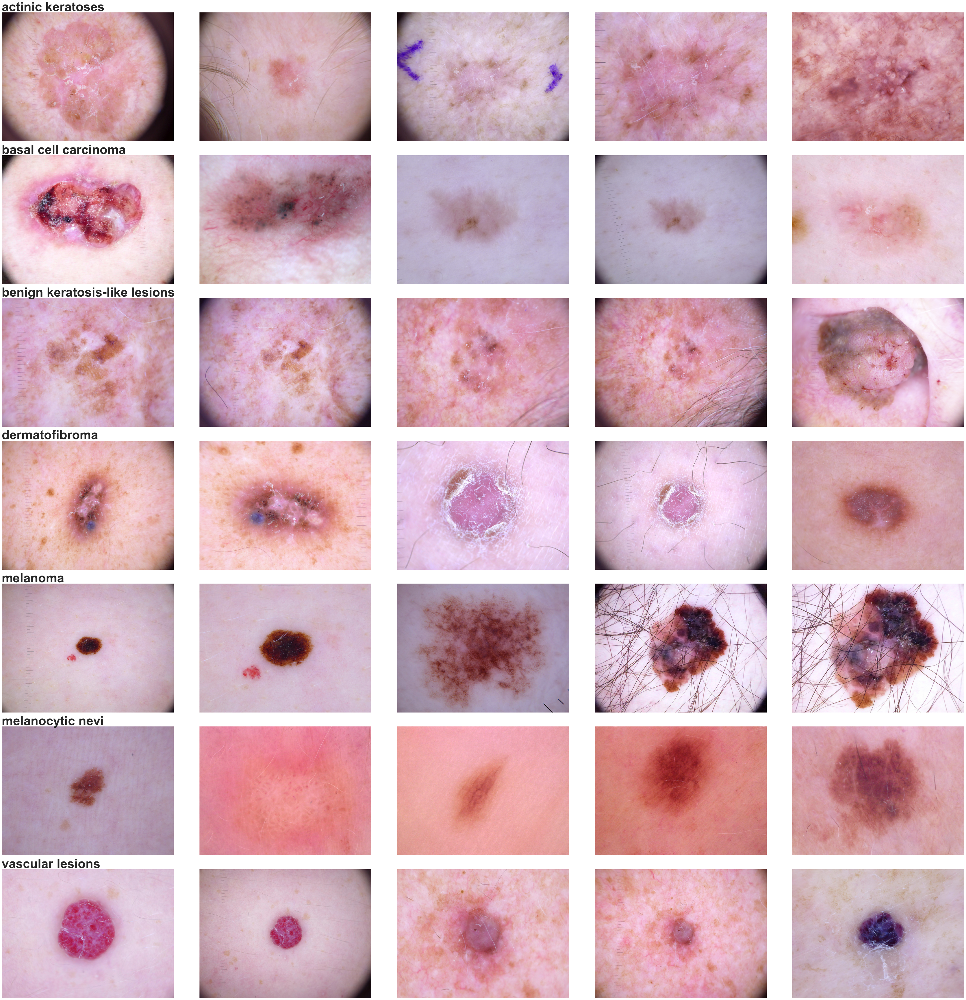

In [13]:
#Visualizing the images

label = [ 'akiec', 'bcc','bkl','df','mel', 'nv', 'vasc']
label_images = []
classes = [ 'actinic keratoses', 'basal cell carcinoma', 'benign keratosis-like lesions', 
           'dermatofibroma','melanoma', 'melanocytic nevi', 'vascular lesions']

fig = plt.figure(figsize=(55, 55))
k = range(7)

for i in label:
    sample = metadata[metadata['dx'] == i]['image_id'][:5]
    label_images.extend(sample)
    
for position,ID in enumerate(label_images):
    labl = metadata[metadata['image_id'] == ID]['dx']
    im_sample = path + "/" + f'/{ID}.jpg'
    im_sample = imageio.imread(im_sample)

    plt.subplot(7,5,position+1)
    plt.imshow(im_sample)
    plt.axis('off')

    if position%5 == 0:
        title = int(position/5)
        plt.title(classes[title], loc='left', size=50, weight="bold")

plt.tight_layout()
plt.show()
plt.savefig('Visualizing_images.png', bbox_inches = 'tight')
plt.close()

In [14]:
# Distribuyendo los datos por clase (resample). 
from sklearn.utils import resample
print(metadata['label'].value_counts())

# Balance de datos.
# Muchas formas de equilibrar los datos ... también puede intentar asignar pesos durante model.fit
# Hay que separar cada clase, volver a muestrear y combinar en un solo dataframe

df_0 = metadata[metadata['label'] == 0]
df_1 = metadata[metadata['label'] == 1]
df_2 = metadata[metadata['label'] == 2]
df_3 = metadata[metadata['label'] == 3]
df_4 = metadata[metadata['label'] == 4]
df_5 = metadata[metadata['label'] == 5]
df_6 = metadata[metadata['label'] == 6]

5    6705
4    1113
2    1099
1     514
0     327
6     142
3     115
Name: label, dtype: int64


In [15]:
# usando resample
n_samples=500 
df_0_balanced = resample(df_0, replace=True, n_samples=n_samples, random_state=42) 
df_1_balanced = resample(df_1, replace=True, n_samples=n_samples, random_state=42) 
df_2_balanced = resample(df_2, replace=True, n_samples=n_samples, random_state=42)
df_3_balanced = resample(df_3, replace=True, n_samples=n_samples, random_state=42)
df_4_balanced = resample(df_4, replace=True, n_samples=n_samples, random_state=42)
df_5_balanced = resample(df_5, replace=True, n_samples=n_samples, random_state=42)
df_6_balanced = resample(df_6, replace=True, n_samples=n_samples, random_state=42)

In [16]:
#Combinado en un solo dataframe
skin_df_balanced = pd.concat([df_0_balanced, df_1_balanced, 
                              df_2_balanced, df_3_balanced, 
                              df_4_balanced, df_5_balanced, df_6_balanced])

#Comprobando la distribución. Ahora todas las clases deberían estar equilibradas.
print(skin_df_balanced['label'].value_counts())

0    500
1    500
2    500
3    500
4    500
5    500
6    500
Name: label, dtype: int64


In [17]:
skin_df_balanced

,lesion_id,image_id,dx,dx_type,age,sex,localization,dataset,label
9789,HAM_0003136,ISIC_0026645,akiec,histo,65.0,male,back,rosendahl,0
9957,HAM_0006587,ISIC_0025780,akiec,histo,70.0,male,face,rosendahl,0
9793,HAM_0005505,ISIC_0024450,akiec,histo,50.0,male,upper extremity,rosendahl,0
9758,HAM_0003455,ISIC_0027896,akiec,histo,75.0,male,hand,rosendahl,0
9875,HAM_0005459,ISIC_0029268,akiec,histo,85.0,male,upper extremity,rosendahl,0
...,...,...,...,...,...,...,...,...,...
2375,HAM_0005989,ISIC_0033123,vasc,histo,25.0,female,back,vidir_modern,6
2436,HAM_0004943,ISIC_0027790,vasc,consensus,50.0,female,face,vidir_molemax,6
2453,HAM_0001038,ISIC_0024706,vasc,consensus,50.0,male,trunk,vidir_molemax,6
2377,HAM_0007097,ISIC_0033762,vasc,histo,60.0,male,trunk,vidir_modern,6


In [18]:
# leyendo imágenes basadas en el ID de imagen del archivo CSV
# Esto garantiza que se lea la imagen correcta para la identificación correcta en el csv

image_path = {os.path.splitext(os.path.basename(x))[0]: x
                     for x in glob(os.path.join('C:/Users/carlo/Documents/HAM10000/', '*', '*.jpg'))}

In [19]:
image_path

{'ISIC_0024306': 'C:/Users/carlo/Documents/HAM10000\\HAM10000_images_part_1\\ISIC_0024306.jpg',
 'ISIC_0024307': 'C:/Users/carlo/Documents/HAM10000\\HAM10000_images_part_1\\ISIC_0024307.jpg',
 'ISIC_0024308': 'C:/Users/carlo/Documents/HAM10000\\HAM10000_images_part_1\\ISIC_0024308.jpg',
 'ISIC_0024309': 'C:/Users/carlo/Documents/HAM10000\\HAM10000_images_part_1\\ISIC_0024309.jpg',
 'ISIC_0024310': 'C:/Users/carlo/Documents/HAM10000\\HAM10000_images_part_1\\ISIC_0024310.jpg',
 'ISIC_0024311': 'C:/Users/carlo/Documents/HAM10000\\HAM10000_images_part_1\\ISIC_0024311.jpg',
 'ISIC_0024312': 'C:/Users/carlo/Documents/HAM10000\\HAM10000_images_part_1\\ISIC_0024312.jpg',
 'ISIC_0024313': 'C:/Users/carlo/Documents/HAM10000\\HAM10000_images_part_1\\ISIC_0024313.jpg',
 'ISIC_0024314': 'C:/Users/carlo/Documents/HAM10000\\HAM10000_images_part_1\\ISIC_0024314.jpg',
 'ISIC_0024315': 'C:/Users/carlo/Documents/HAM10000\\HAM10000_images_part_1\\ISIC_0024315.jpg',
 'ISIC_0024316': 'C:/Users/carlo/Documen

In [20]:
# Definir el path de las imágenes y agregarlas como una nueva columna en el dataframe
skin_df_balanced['path'] = metadata['image_id'].map(image_path.get)
#Usando el path para leer las imágenes.
skin_df_balanced['image'] = skin_df_balanced['path'].map(lambda x: np.asarray(Image.open(x).resize((SIZE,SIZE))))

In [21]:
skin_df_balanced.head(10)

,lesion_id,image_id,dx,dx_type,age,sex,localization,dataset,label,path,image
9789,HAM_0003136,ISIC_0026645,akiec,histo,65.0,male,back,rosendahl,0,C:/Users/carlo/Documents/HAM10000\HAM10000_ima...,"[[[155, 118, 107], [162, 126, 118], [174, 140,..."
9957,HAM_0006587,ISIC_0025780,akiec,histo,70.0,male,face,rosendahl,0,C:/Users/carlo/Documents/HAM10000\HAM10000_ima...,"[[[138, 76, 82], [131, 64, 68], [139, 73, 81],..."
9793,HAM_0005505,ISIC_0024450,akiec,histo,50.0,male,upper extremity,rosendahl,0,C:/Users/carlo/Documents/HAM10000\HAM10000_ima...,"[[[123, 86, 87], [174, 137, 137], [197, 161, 1..."
9758,HAM_0003455,ISIC_0027896,akiec,histo,75.0,male,hand,rosendahl,0,C:/Users/carlo/Documents/HAM10000\HAM10000_ima...,"[[[205, 149, 175], [207, 149, 169], [214, 158,..."
9875,HAM_0005459,ISIC_0029268,akiec,histo,85.0,male,upper extremity,rosendahl,0,C:/Users/carlo/Documents/HAM10000\HAM10000_ima...,"[[[203, 174, 199], [205, 174, 197], [206, 175,..."
9707,HAM_0005931,ISIC_0031191,akiec,histo,60.0,male,lower extremity,rosendahl,0,C:/Users/carlo/Documents/HAM10000\HAM10000_ima...,"[[[249, 213, 234], [249, 211, 229], [250, 218,..."
9789,HAM_0003136,ISIC_0026645,akiec,histo,65.0,male,back,rosendahl,0,C:/Users/carlo/Documents/HAM10000\HAM10000_ima...,"[[[155, 118, 107], [162, 126, 118], [174, 140,..."
9808,HAM_0002705,ISIC_0027178,akiec,histo,65.0,male,scalp,rosendahl,0,C:/Users/carlo/Documents/HAM10000\HAM10000_ima...,"[[[236, 179, 199], [237, 183, 209], [238, 185,..."
9901,HAM_0000005,ISIC_0029638,akiec,histo,75.0,female,lower extremity,rosendahl,0,C:/Users/carlo/Documents/HAM10000\HAM10000_ima...,"[[[198, 167, 170], [204, 172, 174], [204, 166,..."
9774,HAM_0005389,ISIC_0031012,akiec,histo,70.0,male,lower extremity,rosendahl,0,C:/Users/carlo/Documents/HAM10000\HAM10000_ima...,"[[[214, 164, 203], [217, 168, 203], [217, 171,..."


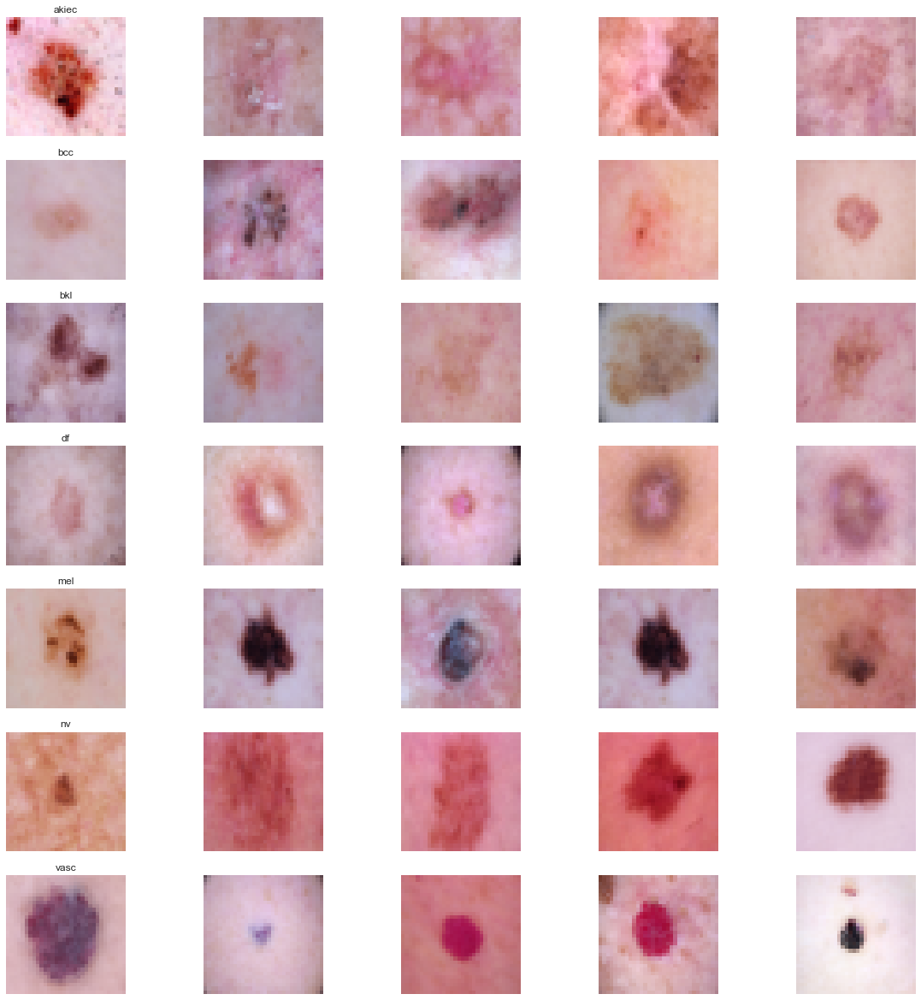

In [22]:
n_samples = 5  # number of samples for plotting
# Plotting
fig, m_axs = plt.subplots(7, n_samples, figsize = (4*n_samples, 3*7))
for n_axs, (type_name, type_rows) in zip(m_axs, 
                                         skin_df_balanced.sort_values(['dx']).groupby('dx')):
    n_axs[0].set_title(type_name)
    for c_ax, (_, c_row) in zip(n_axs, type_rows.sample(n_samples, random_state=1234).iterrows()):
        c_ax.imshow(c_row['image'])
        c_ax.axis('off')

In [23]:
#Convirtiendo la columna de imagenes del dataframe en un array de numpy
X = np.asarray(skin_df_balanced['image'].tolist())
X = X/255.  # Escalar valores a 0-1. También puede utilizar StandardScaler u otro metodo
Y=skin_df_balanced['label']  # Asignando valores de etiqueta a Y
Y_cat = to_categorical(Y, num_classes=7) # Convirtiendo variables a variables categóricas, ya que este es un problema de clasificación

# Diviendo dataset en train y test, respectivamente
x_train, x_test, y_train, y_test = train_test_split(X, Y_cat, test_size=0.25, random_state=42)

In [24]:
# Definiendo el modelo.
# Se puede usar autokeras para encontrar el mejor modelo para este problema.
# También puede cargar redes preentrenadas como mobilenet o VGG16

num_classes = 7

model = Sequential()
model.add(Conv2D(256, (3, 3), activation="relu", input_shape=(SIZE, SIZE, 3)))
#model.add(BatchNormalization())
model.add(MaxPool2D(pool_size=(2, 2)))  
model.add(Dropout(0.3))

model.add(Conv2D(128, (3, 3),activation='relu'))
#model.add(BatchNormalization())
model.add(MaxPool2D(pool_size=(2, 2)))  
model.add(Dropout(0.3))

model.add(Conv2D(64, (3, 3),activation='relu'))
#model.add(BatchNormalization())
model.add(MaxPool2D(pool_size=(2, 2)))  
model.add(Dropout(0.3))
model.add(Flatten())

model.add(Dense(32))
model.add(Dense(7, activation='softmax'))
model.summary()

model.compile(loss='categorical_crossentropy', optimizer='Adam', metrics=['acc'])

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 30, 30, 256)       7168      
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 15, 15, 256)       0         
_________________________________________________________________
dropout (Dropout)            (None, 15, 15, 256)       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 13, 13, 128)       295040    
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 6, 6, 128)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 6, 6, 128)         0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 4, 4, 64)          7

In [25]:
# Train
#You can also use generator to use augmentation during training.

batch_size = 16 
epochs = 50

history = model.fit(
    x_train, y_train,
    epochs=epochs,
    batch_size = batch_size,
    validation_data=(x_test, y_test),
    verbose=2)

score = model.evaluate(x_test, y_test)
print('Test accuracy:', score[1])

Epoch 1/50
165/165 - 16s - loss: 1.9505 - acc: 0.1566 - val_loss: 1.9181 - val_acc: 0.2274
Epoch 2/50
165/165 - 23s - loss: 1.7938 - acc: 0.2389 - val_loss: 1.7719 - val_acc: 0.2571
Epoch 3/50
165/165 - 22s - loss: 1.6864 - acc: 0.3219 - val_loss: 1.6296 - val_acc: 0.3406
Epoch 4/50
165/165 - 19s - loss: 1.5578 - acc: 0.3627 - val_loss: 1.4985 - val_acc: 0.3840
Epoch 5/50
165/165 - 26s - loss: 1.4652 - acc: 0.4152 - val_loss: 1.4461 - val_acc: 0.4057
Epoch 6/50
165/165 - 20s - loss: 1.4086 - acc: 0.4480 - val_loss: 1.4026 - val_acc: 0.4674
Epoch 7/50
165/165 - 21s - loss: 1.3667 - acc: 0.4644 - val_loss: 1.3778 - val_acc: 0.4229
Epoch 8/50
165/165 - 21s - loss: 1.3406 - acc: 0.4758 - val_loss: 1.3181 - val_acc: 0.4857
Epoch 9/50
165/165 - 20s - loss: 1.3002 - acc: 0.4838 - val_loss: 1.3315 - val_acc: 0.4617
Epoch 10/50
165/165 - 20s - loss: 1.2767 - acc: 0.4964 - val_loss: 1.2457 - val_acc: 0.4800
Epoch 11/50
165/165 - 24s - loss: 1.2471 - acc: 0.5036 - val_loss: 1.2539 - val_acc: 0.50

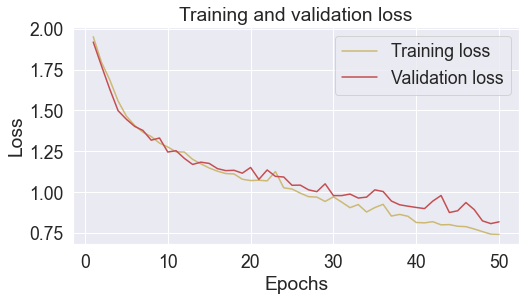

In [32]:
# hacer plot la exactitud y la perdida del set de entrenamiento y validacion para cada epoca
from matplotlib import pyplot as plt

loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt_e = plt.plot(epochs, loss, 'y', label='Training loss')
plt_e = plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt_e = plt.title('Training and validation loss')
plt_e = plt.xlabel('Epochs')
plt_e = plt.ylabel('Loss')
plt_e = plt.legend()
plt_e = plt.show()
plt_e = plt.savefig('Training_and_validation_loss.png', bbox_inches = 'tight')
plt.close()

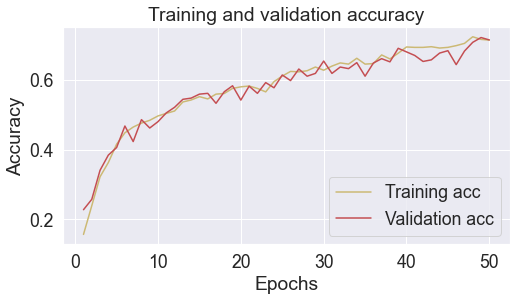

In [33]:
from matplotlib import pyplot as plt

acc = history.history['acc']
val_acc = history.history['val_acc']
plt_f = plt.plot(epochs, acc, 'y', label='Training acc')
plt_f = plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt_f = plt.title('Training and validation accuracy')
plt_f = plt.xlabel('Epochs')
plt_f = plt.ylabel('Accuracy')
plt_f = plt.legend()
plt_f = plt.show()
plt_f = plt.savefig('Training_and_validation_accuracy.png', bbox_inches = 'tight')
plt.close()

In [34]:
# Prediction on test data
y_pred = model.predict(x_test)
# Convert predictions classes to one hot vectors 
y_pred_classes = np.argmax(y_pred, axis = 1) 
# Convert test data to one hot vectors
y_true = np.argmax(y_test, axis = 1) 

In [35]:
y_pred_classes

array([0, 1, 4, 3, 2, 4, 3, 3, 2, 0, 1, 2, 6, 1, 1, 1, 0, 0, 6, 5, 0, 0,
       4, 1, 2, 2, 1, 3, 1, 6, 6, 3, 5, 1, 6, 6, 0, 0, 1, 4, 3, 6, 1, 1,
       0, 0, 3, 3, 1, 0, 0, 2, 5, 6, 0, 0, 4, 0, 2, 3, 6, 5, 0, 0, 3, 6,
       0, 3, 0, 5, 5, 1, 2, 4, 1, 0, 6, 5, 6, 3, 6, 6, 6, 6, 5, 5, 2, 4,
       0, 1, 2, 6, 1, 5, 6, 5, 0, 2, 3, 1, 0, 5, 1, 0, 0, 0, 6, 6, 1, 1,
       0, 1, 0, 0, 4, 1, 6, 3, 5, 1, 1, 5, 6, 0, 1, 1, 4, 3, 1, 0, 3, 0,
       0, 6, 5, 4, 6, 6, 0, 3, 2, 6, 0, 3, 5, 0, 4, 0, 2, 0, 0, 4, 4, 0,
       5, 2, 1, 3, 0, 3, 0, 4, 2, 5, 5, 0, 1, 4, 4, 1, 3, 3, 0, 2, 3, 6,
       1, 5, 1, 6, 6, 2, 2, 0, 2, 3, 0, 3, 0, 5, 5, 5, 6, 3, 4, 6, 4, 3,
       2, 0, 2, 0, 3, 2, 1, 5, 5, 6, 6, 4, 2, 0, 6, 6, 6, 6, 2, 5, 5, 0,
       0, 1, 0, 0, 4, 3, 6, 2, 1, 3, 4, 1, 1, 6, 1, 3, 4, 3, 2, 1, 1, 0,
       0, 4, 3, 3, 1, 1, 6, 3, 2, 6, 1, 1, 1, 3, 5, 2, 1, 3, 5, 0, 0, 2,
       1, 4, 1, 5, 0, 0, 6, 0, 0, 1, 1, 0, 0, 6, 5, 3, 2, 3, 0, 6, 0, 1,
       0, 4, 1, 6, 1, 1, 3, 2, 5, 4, 5, 0, 0, 3, 3,

In [36]:
# Matriz de confusion
cm = confusion_matrix(y_true, y_pred_classes)
fig, ax = plt.subplots(figsize=(6,6))
sns.set(font_scale=1.6)
sns.heatmap(cm, annot=True, linewidths=.5, ax=ax)
fig.savefig('confusion_matrix.png', bbox_inches = 'tight')
plt.close()

In [37]:
#PLot fractional incorrect misclassifications
incorr_fraction = 1 - np.diag(cm) / np.sum(cm, axis=1)
plt.bar(np.arange(7), incorr_fraction)
plt.xlabel('True Label')
plt.ylabel('Fraction of incorrect predictions')
plt.savefig('incorrect_misclassifications.png', bbox_inches = 'tight')
plt.close()